# **Background Extraction with Gaussian Mixture Model**

In this notebook, we will perform background extraction using a Gaussian Mixture Model. We very loosely follow the approach from this paper: http://www.ai.mit.edu/projects/vsam/Publications/stauffer_cvpr98_track.pdf. The purpose of this tutorial is to compare the performance to the simple background extraction method that only uses basiv opencv functions.

See also: https://www.youtube.com/watch?v=0nz8JMyFF14&list=PL2zRqk16wsdoYzrWStffqBAoUY8XdvatV&index=15

In [1]:
import os
from glob import glob
import re
import numpy as np
import cv2
import matplotlib.pyplot as plt
%matplotlib inline

### Visualize the data

In [2]:
# get properly sorted images
image_paths = sorted(glob('nvidia/*.jpg'), key=lambda x:float(re.findall("(\d+)",x)[0]))

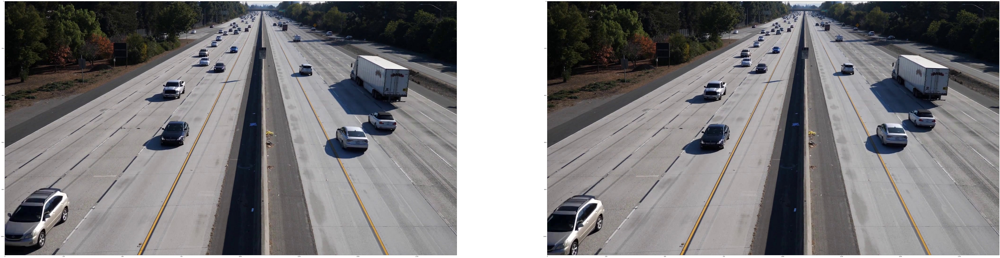

In [3]:
idx = 56

img1_rgb = cv2.cvtColor(cv2.imread(image_paths[idx]), cv2.COLOR_BGR2RGB)
img2_rgb = cv2.cvtColor(cv2.imread(image_paths[idx+1]), cv2.COLOR_BGR2RGB)

fig, ax = plt.subplots(1, 2, figsize=(150, 75))
ax[0].imshow(img1_rgb)
ax[1].imshow(img2_rgb);

### **GMM Approach**

For the GMM approach we assume that the camera is static, but the scene is changing. We will look at each pixel location and take a histogram of it's variations. The idea, is that the majority of it's intensities will come from the true background and the remaining intensities will come from the foreground.



In [5]:
img1_rgb.shape

(1080, 1920, 3)

In [45]:
# Allocate buffer for storing frames
n_frames = len(image_paths)
frames = np.zeros((n_frames, 1080, 1920, 3))

# iterate through all images
for i in range(n_frames - 1):
    # get RGB image
    image = cv2.cvtColor(cv2.imread(image_paths[i]), cv2.COLOR_BGR2RGB)

    # add to frame buffer
    frames[i] = image

Get sample pixel to investigate

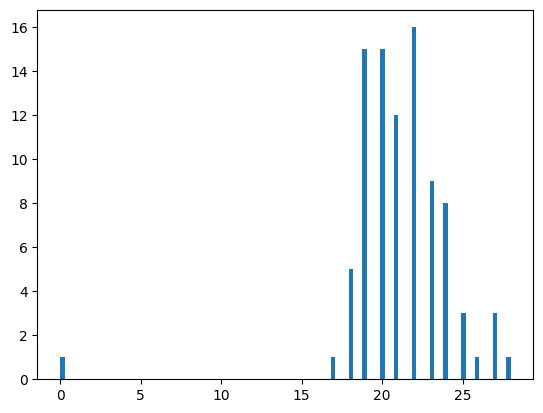

In [74]:
sample = frames[:, 0, 0, 2]
plt.hist(sample, bins=100);

In [20]:
hist, edges = np.histogram(sample, bins=90)
edges[np.argmax(hist)]

160.20000000000002

We can take the mean pixel value and see that we already get a decent background without even trying. We notice the dark streaks from the cars that were still apparent in the naive approach.

In [9]:
mean_pixel_value = np.mean(frames, axis=0)

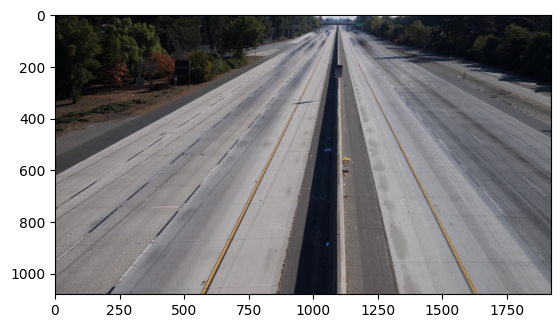

In [10]:
plt.imshow(cv2.cvtColor(mean_pixel_value.astype(np.uint8), cv2.COLOR_BGR2RGB));

### Gaussian Mixture Model with 2 clusters

We will train a seperate GMM for each pixel, we do this because we are not interested in the relationship across pixels, we only want to model a single pixel at a time. However, for speed we model the pixels of each color chanel together, but assume that they are independent. 

We will uses opencv ML to implement the GMM, since opencv is genreally faster than sklearn and numpy


NOTE: The default covariance matrix of opencv EM is diagonal=1. See https://docs.opencv.org/3.4/d1/dfb/classcv_1_1ml_1_1EM.html


In [175]:
NUM_CLUSTERS = 2

# allocate a new background matrix
background = np.zeros_like(frames[0])

In [207]:
for i in range(frames.shape[1]):
    for j in range(frames.shape[2]):
        # create new GMM class
        gmm = cv2.ml.EM.create()

        # set number of clusters and covariance matrix type
        gmm.setClustersNumber(2)
        # gmm.setCovarianceMatrixType(0) # 0 - spherical

        # train with EM Algorithm on current pixel/color channel
        gmm.trainEM(frames[:, i, j, :]);

        # get weights, covariances, and means
        weights = gmm.getWeights()
        mu = gmm.getMeans()
        # sig = np.array(gmm.getCovs())

        # place mean with lowest variance and into the background matrix
        # background[i, j, :] = mu[np.argmin(sig.sum(axis=1).sum(axis=1))]
        background[i, j, :] = mu[np.argmax(weights)] # get largest weighted background

        # per Stauffer get pixels with largest weight/sigma
        # idx = np.argmax(np.array([np.sum(weights[0][0]/np.diag(sig[0])), 
        #                           np.sum(weights[0][1]/np.diag(sig[1]))]))

        # background[i, j, :] = mu[idx]                        
        


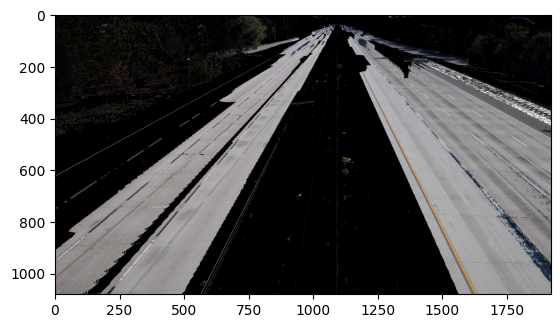

In [208]:
# max (weight/variance)
plt.imshow(background.astype(np.uint8))

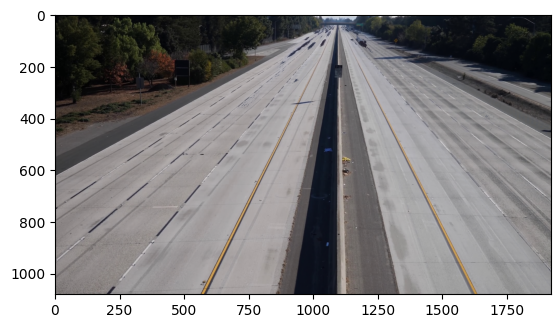

In [194]:
# max weight
plt.imshow(background.astype(np.uint8))

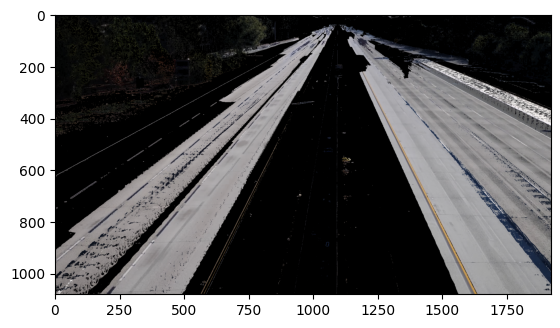

In [177]:
# min variance
plt.imshow(background.astype(np.uint8))

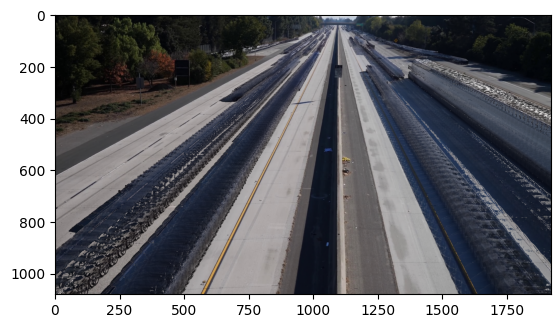

In [163]:
# max variance
plt.imshow(background.astype(np.uint8))

### Conclusion

The loop took a bit over 20 minutes to run each time. The resultng background does not have the larger faint dark streaks as produced by the median and mean methods, but there are still dark streaks in the back of the road. It is likely because, the cars in that region occupied more pixel space. A more robust modelling apporach may be able to fix this (NOTE: The paper recommends a minimum of 3 Gaussians, but we only modeled 2).